In [5]:
%load_ext autoreload

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [14]:
import sys, os
import numpy as np
import pandas as pd
import seaborn as sns
sns.set(color_codes=True)
import matplotlib.pyplot as plt

if not "../data_processing" in sys.path:
    sys.path.append("../data_processing")

%autoreload
import build_dataset
import dataframe_exploration

ROOT /Users/mortenolsenosvik/Documents/NTNU/Master/master-thesis/src
/Users/mortenolsenosvik/Documents/NTNU/Master/master-thesis/src


In [22]:
wt_instance = build_dataset.wt_data.load_instance("WTG01",load_minimal=False)



Loading WTG01...
Loaded WTG01


In [ ]:
# ----- Used to create and build a csv file of the data set -----

'''
df = build_dataset.create_rms_datasets_for_one_component(wt_instance, 'GbxHssRr;0,0102;m/s2', 
                                                         power_threshold=2500,plot=False, bins=50, 
                                                         plot_vertical_lines=False)

build_dataset.save_dataframe_to_csv(df, 'GbxHssRr_RMS_power>2500_WTG01.csv')
'''

### Load data set from csv file

In [7]:
path = '/Volumes/OsvikExtra/VibrationData/RMS_dataset/GbxHssRr_RMS_power>2500_WTG01.csv'
data = pd.read_csv(path)
data.head()

,AvgPower,ActPower,AvgRotSpeed,WindSpeed,NacelleDirection,GbxHssRr_RMS_0,GbxHssRr_RMS_1,GbxHssRr_RMS_2,GbxHssRr_RMS_3,GbxHssRr_RMS_4,...,GbxHssRr_RMS_40,GbxHssRr_RMS_41,GbxHssRr_RMS_42,GbxHssRr_RMS_43,GbxHssRr_RMS_44,GbxHssRr_RMS_45,GbxHssRr_RMS_46,GbxHssRr_RMS_47,GbxHssRr_RMS_48,GbxHssRr_RMS_49
0,2500.973877,3090.899902,1511.167622,13.0,232.899994,0.529806,0.396315,0.926229,0.784296,1.689014,...,1.107841,1.689887,1.884569,2.108670,3.132671,2.855787,3.668806,3.355471,1.887401,0.927872
1,2565.207520,2660.399902,1472.724506,9.9,53.900002,0.519244,0.297510,0.857385,0.771858,1.000674,...,1.078498,1.583077,1.868731,2.318457,2.936169,2.918674,3.745910,3.281026,1.667363,0.995451
2,2861.552002,3301.899902,1499.039959,12.0,262.399994,0.537803,0.492195,0.918529,0.819567,2.557961,...,1.044200,1.527561,1.749744,2.021772,2.802417,2.649571,3.407016,3.057615,1.654562,0.866629
3,3073.377930,3307.399902,1492.741102,15.1,245.600006,0.655595,0.499201,0.900849,0.873749,2.765626,...,1.051084,1.471833,1.688985,2.041691,2.650884,2.545420,3.355640,3.010029,1.543250,0.827142
4,2630.640625,2335.399902,1458.801583,7.3,296.399994,0.552800,0.312219,0.926188,0.819309,1.080637,...,1.040459,1.557635,2.074641,2.154511,2.639528,2.810245,3.425632,3.298253,1.666922,0.955386


### Correlation plot, unfiltered data set

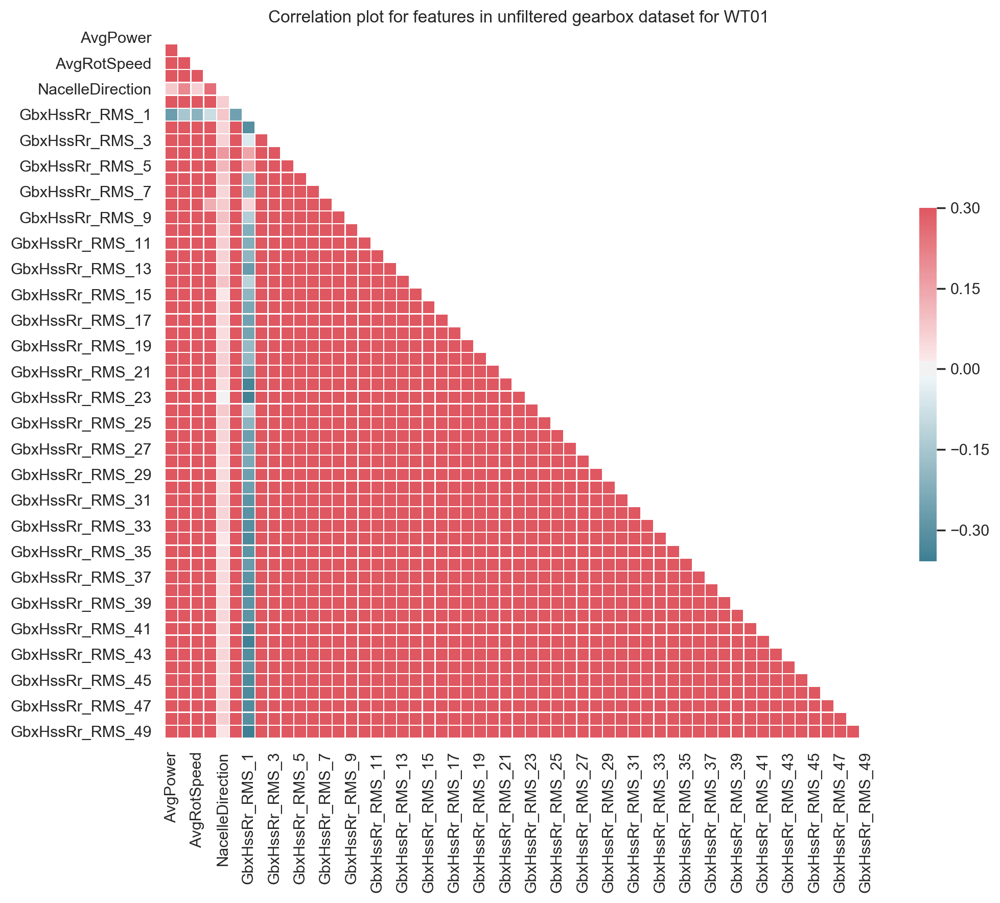

In [8]:
path = '/Volumes/OsvikExtra/VibrationData/RMS_dataset/GbxHssRr_RMS_WTG01.csv'
save_to_file_name = "Correlation_plot_wtg01_Gearbox"
plot_title = "Correlation plot for features in unfiltered gearbox dataset for WT01"

dataframe_exploration.create_save_correlation_plot(path, save_to_file_name, plot_title)

### Correlation plot, filtered data set

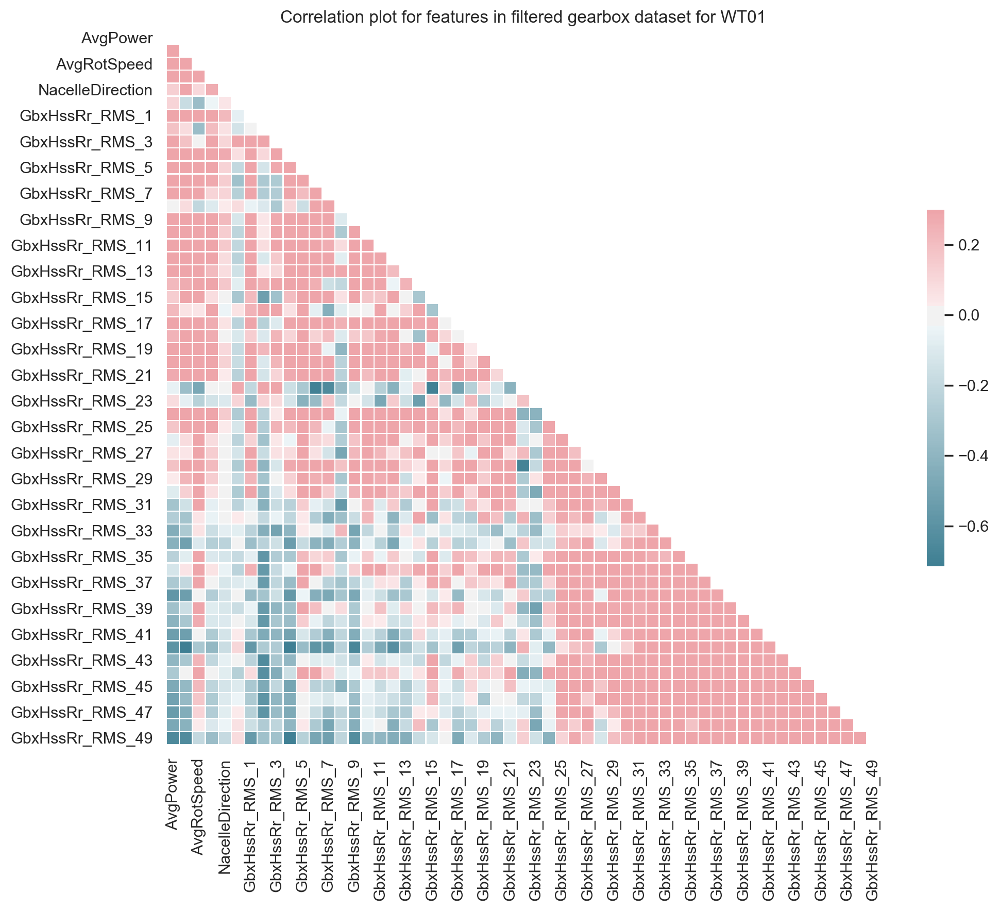

In [9]:
path = '/Volumes/OsvikExtra/VibrationData/RMS_dataset/GbxHssRr_RMS_power>2500_WTG01.csv'
save_to_file_name = "Correlation_plot_wtg01_Gearbox"
plot_title = "Correlation plot for features in filtered gearbox dataset for WT01"

dataframe_exploration.create_save_correlation_plot(path, save_to_file_name, plot_title)

## Plot average rot speed (high speed shaft) for all intervals with avg_power > 2500

color codes: 
red: hgih rot speed which gives high rms values in bin 5

yellow: low rot speeds which gives high rms values in bin 1,2 or 3. The first line at interval 30 (with very low 
rot speed) has only high rot speed in bin 1

light blue: high rot speed but regular rms values

green horisontal line: 1550 rpm (rotational speed)

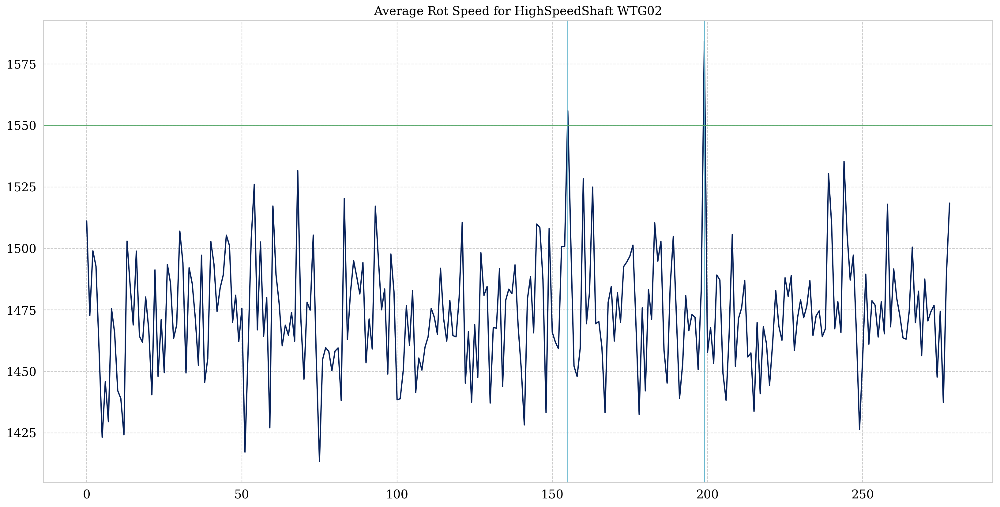

In [16]:
x = np.arange(data.shape[0])
y = data['AvgRotSpeed']
plt.figure(figsize=(20,10))
plt.title('Average Rot Speed for HighSpeedShaft WTG01')
plt.plot(x, y)
plt.axvline(x=155,  c='c', linewidth=1)
plt.axvline(x=199, c='c', linewidth=1)
plt.axhline(y=1550, c='g', linewidth=1)
plt.show()

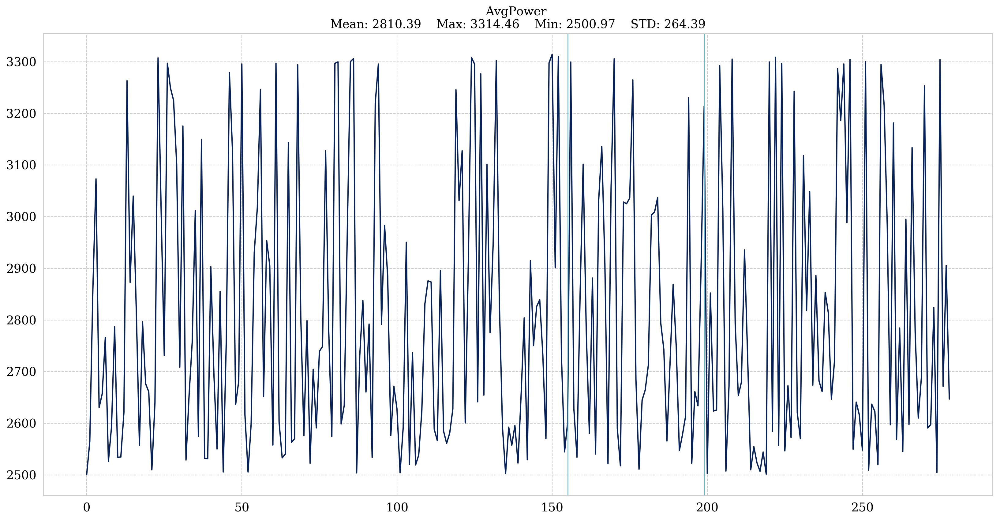

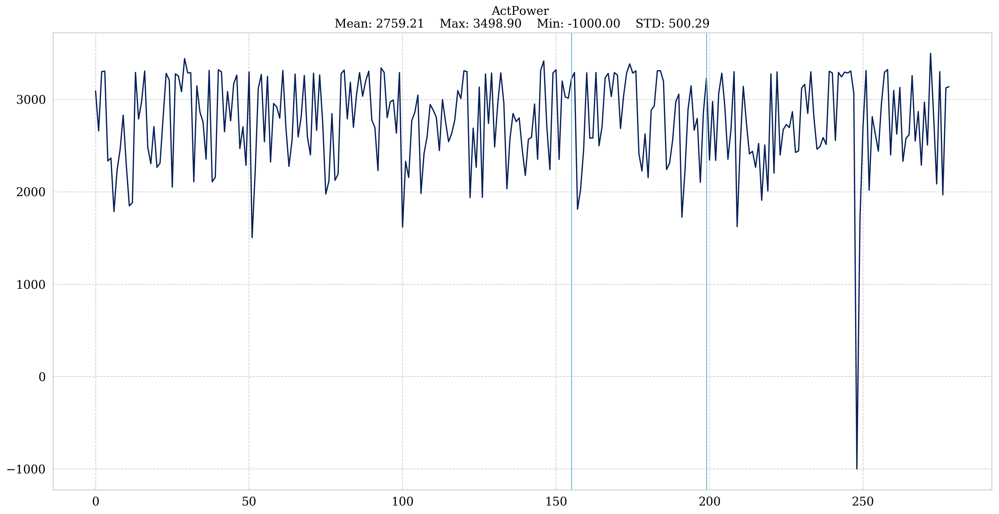

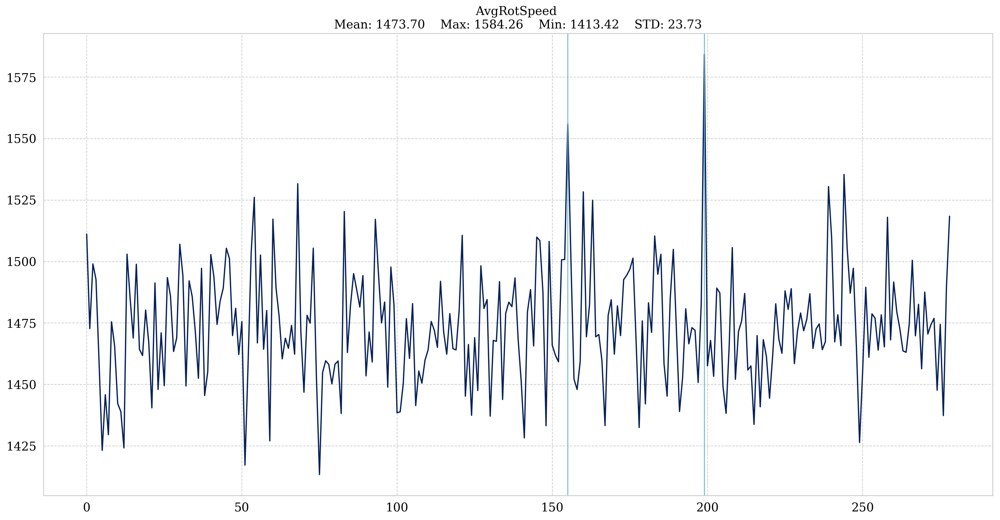

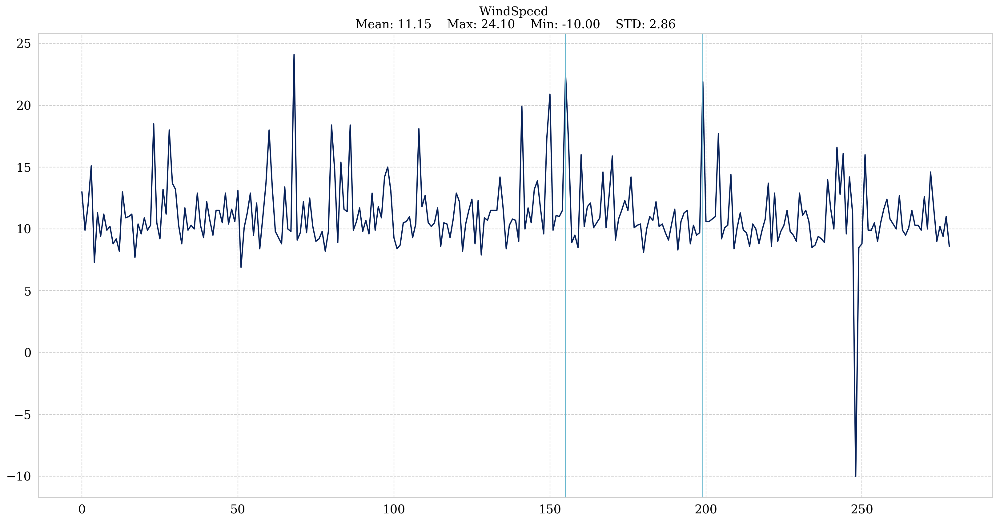

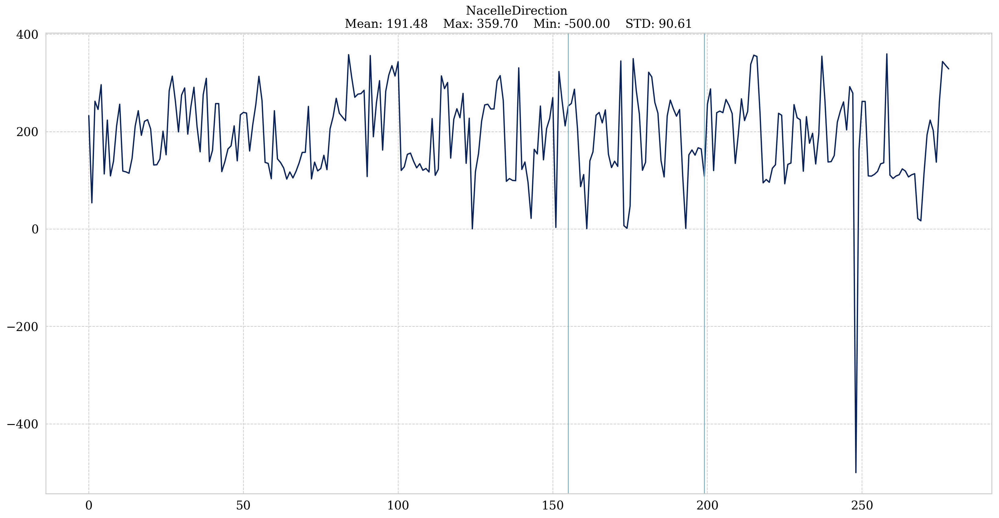

...

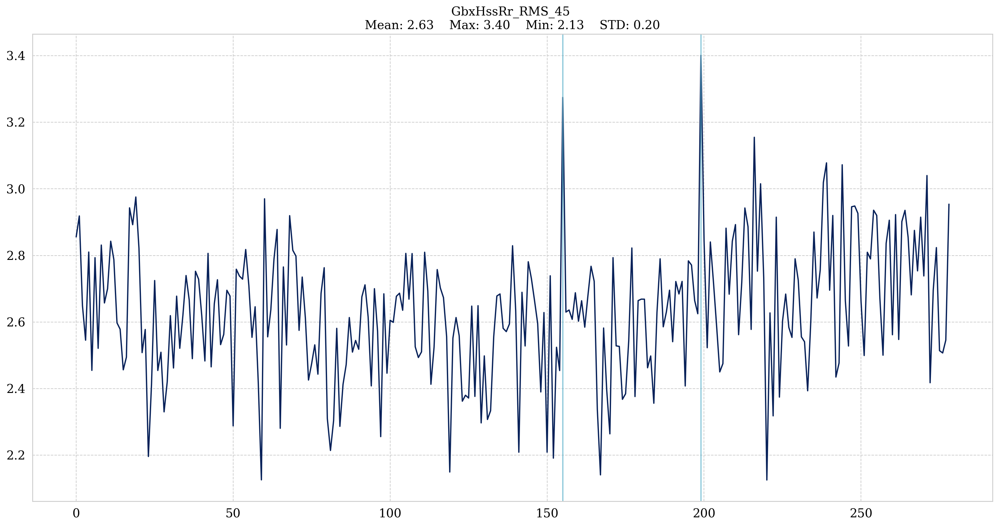

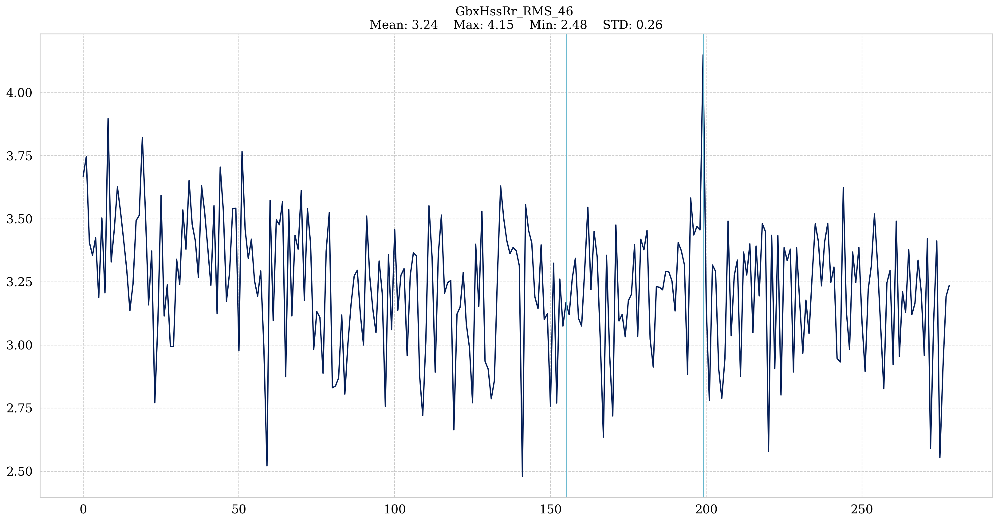

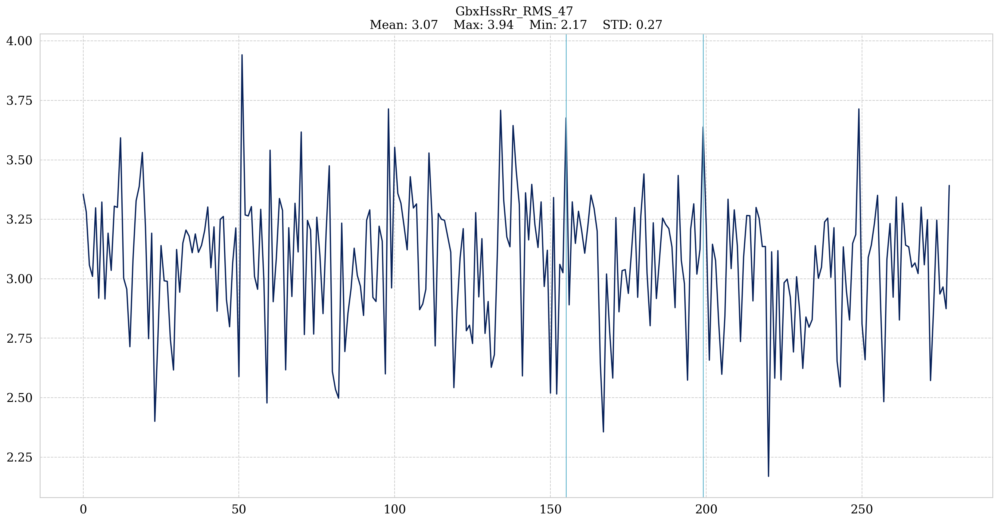

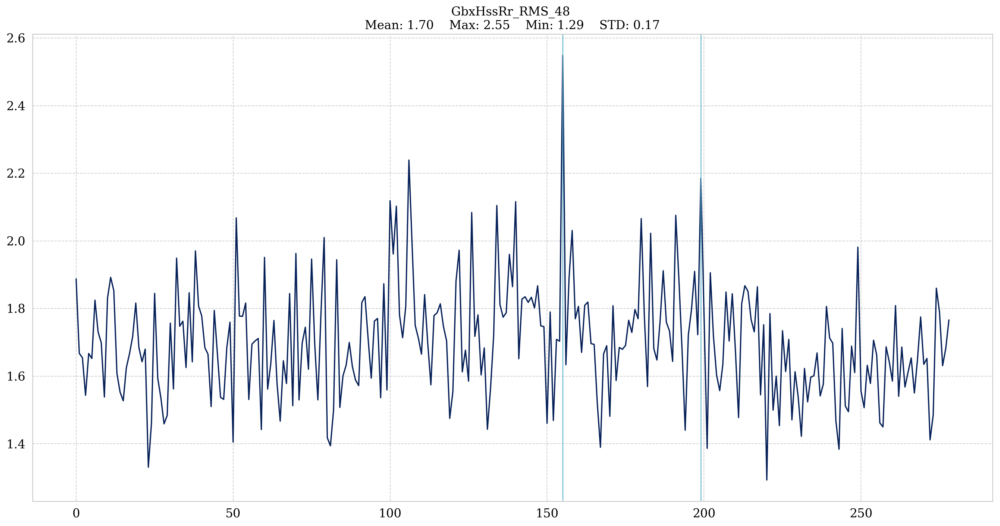

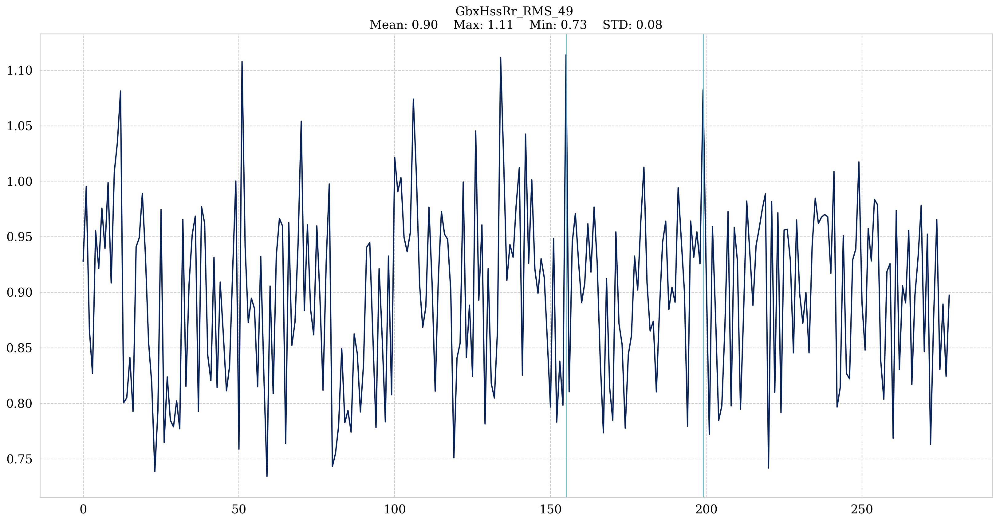

In [17]:
x=np.arange(len(data))
for i, name in enumerate(data.columns):
    plt.figure(figsize=(20,10))
    y = data.values[:,i]
    mean_val = np.mean(y)
    max_val = np.max(y)
    min_val = np.min(y)
    std_val = np.std(y)
    plt.title(f'{name} \nMean: {mean_val:.2f}    Max: {max_val:.2f}    Min: {min_val:.2f}    STD: {std_val:.2f}')
    plt.plot(x, y)
    plt.axvline(x=155,  c='c', linewidth=1)
    plt.axvline(x=199, c='c', linewidth=1)
    plt.show()

In [33]:
print(f"AvgPower value at test sample: {data.iloc[130]['AvgPower']}")
print('\nBlue lines')
print(f"AvgPower value at first high rot speed: {data.iloc[155]['AvgPower']}")
print(f"AvgPower value at second high rot speed: {data.iloc[199]['AvgPower']}")

AvgPower value at test sample: 2775.533203125

Blue lines
AvgPower value at first high rot speed: 2601.592285156
AvgPower value at second high rot speed: 3214.3076171879998


In [31]:
%autoreload
import build_dataset

In [34]:
pwr_values = [2775.533203125, 2601.592285156, 3214.307617188]

186


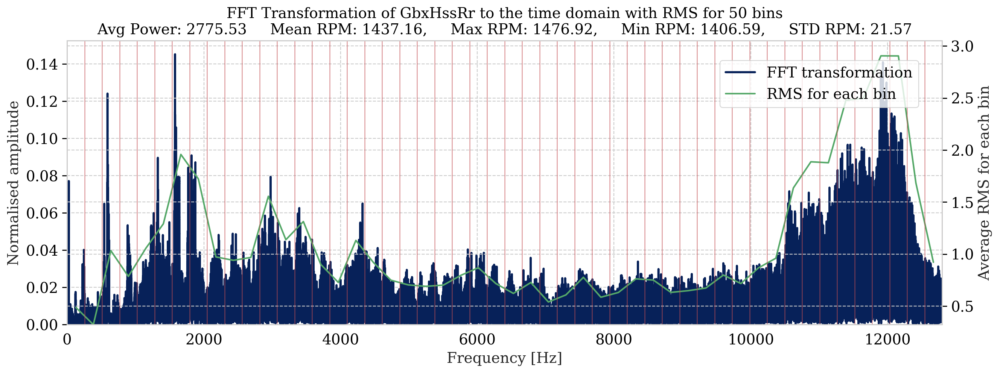

219


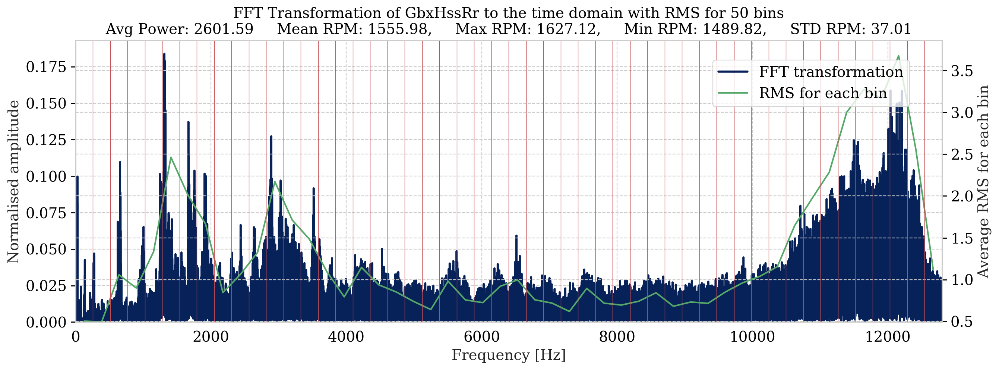

290


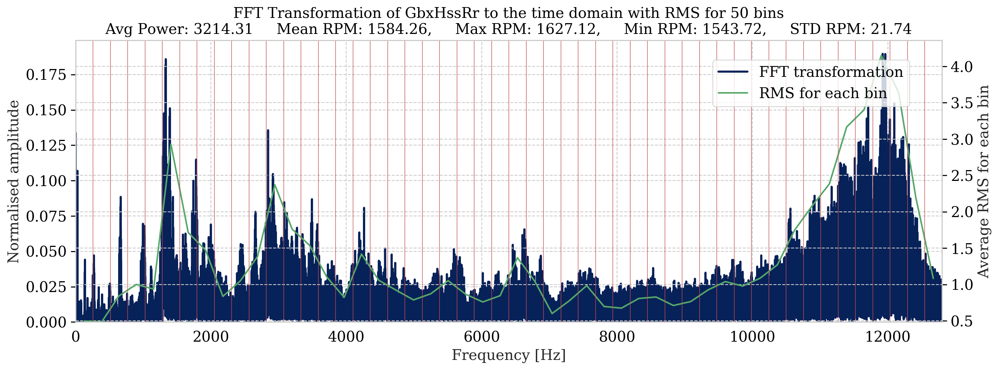

3 / 414 intervals added to dataframe


In [35]:
df = build_dataset.create_rms_datasets_for_one_component(wt_instance, 'GbxHssRr;0,0102;m/s2', 
                                                         power_threshold=2500,plot=True, bins=50, 
                                                         plot_vertical_lines=True,
                                                         avg_pwr_values = pwr_values)